In [112]:
import os
import tensorflow as tf
from tensorflow.keras import backend
from sagemaker.tensorflow import TensorFlowModel

model_data = 's3://msk-serverless-workshop-cfn-destinationbucket-1i5chuhor3dqf/model_5.tar.gz'
role = 'SageMaker-nshaik66'

model = TensorFlowModel(model_data=model_data,
                        framework_version='2.8', role=role)

INSTANCE_TYPE = 'ml.m5.xlarge'
ENDPOINT_NAME = 'yolov5l-6-demo'

predictor = model.deploy(initial_instance_count=1,
                            instance_type=INSTANCE_TYPE,
                            endpoint_name=ENDPOINT_NAME)

update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


---!

In [1]:
def prep_image(img_path):
    img = cv2.imread(img_path)
    #print(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    height,width = img.shape[0], img.shape[1]

    top_pad = bot_pad = height % 640 // 2
    left_pad = right_pad = width % 640 // 2

    img_padded = cv2.copyMakeBorder(img, top_pad, bot_pad, left_pad, right_pad, cv2.BORDER_CONSTANT, value=[114,114,114])
    img_padded_and_resized = cv2.resize(img_padded,(640,640))
    #calculate border padding

    #img = cv2.resize(img, (4032,3040))

    #plt.imshow(img_padded_and_resized)
    return img_padded_and_resized

{'predictions': [{'output_0': [[0.180876553, 0.467762023, 0.181951791, 0.472079426], [0.007048083, 0.577904284, 0.00706121, 0.589095891], [0.00935307145, 0.560911298, 0.00936321, 0.586961389], [0.00819778722, 0.532026, 0.00821055565, 0.562835395], [-0.00136061572, 0.602475, -0.00134865078, 0.615736067], [0.00793358311, 0.54552573, 0.00794531778, 0.574054897], [0.0419304632, -0.000354632561, 0.0498527028, 0.00169433351], [0.00677047, -0.00804211758, 0.00678213593, 0.0490974784], [0.0195465423, 0.00116820529, 0.021970842, 0.00326002948], [0.00770039763, 0.518513083, 0.00771171879, 0.552100658], [0.00764149241, 0.505540252, 0.00765314884, 0.540092468], [0.18045105, 0.51782459, 0.182767019, 0.522479713], [0.180874631, 0.477868, 0.182062373, 0.486348838], [-0.000972125214, 0.594830692, -0.000964587671, 0.601121247], [0.00739767356, 0.479435891, 0.00740953861, 0.516252697], [0.00737917935, 0.492582351, 0.0073906905, 0.528281391], [0.056098789, 0.000342094456, 0.0602829978, 0.00284989225], [0

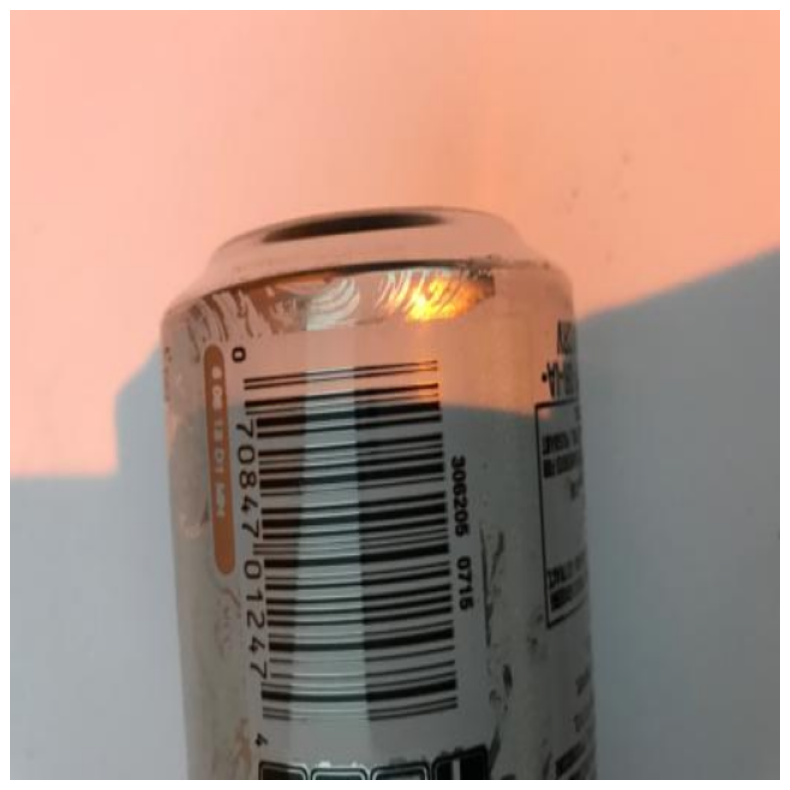

In [116]:
import numpy as np
import json
import boto3, botocore
import cv2
%matplotlib inline
import matplotlib.pyplot as plt

config = botocore.config.Config(read_timeout=500)

runtime = boto3.client('runtime.sagemaker', config=config)
ENDPOINT_NAME = 'yolov5l-6-demo'

modelHeight, modelWidth = 640, 640

blank_image =cv2.resize(cv2.imread('metal34.jpg'),(640,640)) #np.zeros((modelHeight,modelWidth,3), np.uint8)
blank_image = cv2.cvtColor(blank_image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,10))
plt.axis('off')
blank_image=blank_image
plt.imshow(blank_image)

data = np.array(blank_image.astype(np.float32))
payload = json.dumps([data.tolist()])

response = runtime.invoke_endpoint(EndpointName=ENDPOINT_NAME,
ContentType='application/json',
Body=payload)

result = json.loads(response['Body'].read().decode())
print(result)
# print('Results: ', labels[int(result['predictions'][0]['output_2'][0])])

In [22]:
!ls

glass7.jpg  lost+found	Untitled.ipynb


[[[255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 195.0, 177.0],
  [255.0, 194.0, 177.0],
  [255.0, 194.0, 176.0],
  [255.0, 194.0, 176.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],
  [254.0, 193.0, 175.0],


In [73]:
(result['predictions'])

[{'output_2': [0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0],
  'output_3': 0,
  'output_0': [[0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0],
   [0.0,

In [62]:
(result['predictions'])

[{'output_0': [[0.181344017, 0.97437042, 0.181908414, 0.988270223],
   [0.881186426, 0.968561828, 0.882543, 0.99415046],
   [0.893740892, 0.968941629, 0.895321965, 0.993803322],
   [0.906474113, 0.967472196, 0.907948375, 0.995282054],
   [0.0441408, 0.217462301, 0.045139946, 0.220803738],
   [0.0811789557, 0.976676762, 0.0818952695, 0.985969603],
   [0.218723118, 0.977622688, 0.21948424, 0.985034168],
   [0.281336188, 0.976931036, 0.281982, 0.985697687],
   [0.231254503, 0.978078246, 0.232001707, 0.984575272],
   [0.256074071, 0.977472126, 0.256978035, 0.985272944],
   [0.269176781, 0.977957606, 0.270452261, 0.984704137],
   [0.0936454609, 0.976755559, 0.0943884477, 0.985876501],
   [0.156373128, 0.976073623, 0.156887636, 0.986517906],
   [0.868654, 0.968834698, 0.869965196, 0.993858516],
   [0.206242189, 0.977077305, 0.207029536, 0.985573351],
   [0.193802208, 0.9766047, 0.19447124, 0.986044884],
   [0.168983489, 0.976075, 0.169466078, 0.986541808],
   [0.106129915, 0.977138638, 0.106

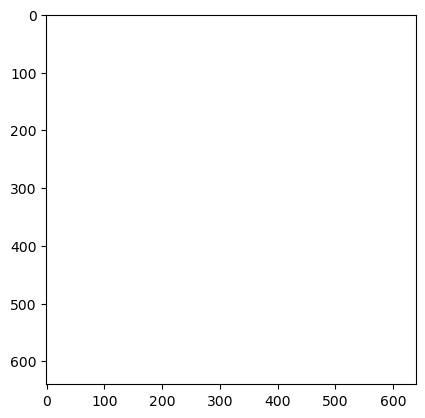

In [7]:
plt.imshow(b2*255)

In [42]:
predictions = result['predictions'][0]
boxes = predictions[:, :4] # x1, y1, x2, y2
scores = predictions[:, 4]
categories = predictions[:, 5]

TypeError: unhashable type: 'slice'

In [53]:
labels[int(result['predictions'][0]['output_2'][0])]

'bio'

In [74]:
labels={0: 'other', 1:'cardboard',2:'glass',3:'metal',4:'paper', 5:'bio'}


In [60]:
result['predictions'][0]

{'output_0': [[0.0561559349, 0.96841836, 0.0570009127, 0.969973922],
  [0.193523899, 0.968604624, 0.194633797, 0.96979779],
  [0.206092909, 0.968587637, 0.207064942, 0.96980238],
  [0.130935371, 0.968433499, 0.132197827, 0.969996214],
  [0.155869767, 0.968450725, 0.157302871, 0.970006168],
  [0.168446288, 0.968450546, 0.169685677, 0.969972253],
  [0.181055814, 0.968416274, 0.182107091, 0.969982684],
  [0.143457487, 0.96840483, 0.144627526, 0.969936669],
  [0.368810177, 0.204843819, 0.369113624, 0.207953244],
  [0.381299645, 0.204903126, 0.381758243, 0.207896858],
  [0.720498204, 0.431846708, 0.723937273, 0.433149844],
  [0.0931167677, 0.968593836, 0.0950658694, 0.969937444],
  [0.105807364, 0.96850419, 0.107356369, 0.969865918],
  [0.231086195, 0.968576789, 0.232015193, 0.969824672],
  [0.0685467869, 0.968457699, 0.0696074516, 0.969981074],
  [0.0809508115, 0.968489885, 0.082250163, 0.969976068],
  [0.699937344, 0.363406837, 0.722800851, 0.512233675],
  [0.717382729, 0.425649017, 0.723

In [76]:
payload

'[[[[255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 195.0, 177.0], [255.0, 194.0, 177.0], [255.0, 194.0, 176.0], [255.0, 194.0, 176.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0, 193.0, 175.0], [254.0,

In [107]:
len(result['predictions'][0])

25200

In [89]:
 0.999694+6.10704e-12+9.07479514e-09+1.59247122e-06+6.43877866e-06+3.63506445e-07

0.9997024038372271

In [117]:
result['predictions'][0]

{'output_0': [[0.180876553, 0.467762023, 0.181951791, 0.472079426],
  [0.007048083, 0.577904284, 0.00706121, 0.589095891],
  [0.00935307145, 0.560911298, 0.00936321, 0.586961389],
  [0.00819778722, 0.532026, 0.00821055565, 0.562835395],
  [-0.00136061572, 0.602475, -0.00134865078, 0.615736067],
  [0.00793358311, 0.54552573, 0.00794531778, 0.574054897],
  [0.0419304632, -0.000354632561, 0.0498527028, 0.00169433351],
  [0.00677047, -0.00804211758, 0.00678213593, 0.0490974784],
  [0.0195465423, 0.00116820529, 0.021970842, 0.00326002948],
  [0.00770039763, 0.518513083, 0.00771171879, 0.552100658],
  [0.00764149241, 0.505540252, 0.00765314884, 0.540092468],
  [0.18045105, 0.51782459, 0.182767019, 0.522479713],
  [0.180874631, 0.477868, 0.182062373, 0.486348838],
  [-0.000972125214, 0.594830692, -0.000964587671, 0.601121247],
  [0.00739767356, 0.479435891, 0.00740953861, 0.516252697],
  [0.00737917935, 0.492582351, 0.0073906905, 0.528281391],
  [0.056098789, 0.000342094456, 0.0602829978, 0.0